# Experiment 2.0.1
Searching for a fail case by varying illumination (2nd attempt).

Carrying on from experiment 2.0.0. 

## 1. Experiment improvements
This time, I make sure each image crop contains an object that corresponds to an ImageNet class. Many of the images in 2.0.0 contained no objects have corresponding ImageNet labels.

I also noticed that the images have an embedded colorspace, "Linear Rec2020 RGB", and this should be converted to whatever is expected by ResNet. This was not done in 2.0.0, but is done here in 2.0.1.

In [28]:
import tempfile
import zipfile
import urllib
import numpy as np
import torch
import pathlib
import torchvision as tv
import torchvision.datasets
import torchvision.models
import torchvision.transforms
import pandas as pd
from icecream import ic
import json
import xarray as xr
import matplotlib as mpl
import matplotlib.pyplot as plt
from collections import namedtuple
import ipyplot
import cv2
import einops
import PIL
import PIL.ImageCms
import IPython

In [2]:
with open('./resources/imagenet-simple-labels.json') as f:
    labels = json.load(f)
    labels_to_id = {s:i for (i,s) in enumerate(labels)}
    
    
NUM_CLASSES = 1000
assert NUM_CLASSES == len(labels)
    
    
def class_id_to_label(cid):
    assert int(cid) == cid
    cid = int(cid)
    return labels[cid]


def label_to_class_id(label):
    return labels_to_id[label]

In [3]:
def imshow(img):
    """Show image. 
    
    Image is a HWC numpy array with values in the range 0-1."""
    img = img*255
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    # cv2 imencode takes images in HWC dimension order.
    _,ret = cv2.imencode('.jpg', img) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i) 
    
    
def imlist(images, labels=None, use_tabs=False):
    if use_tabs:
        ipyplot.plot_class_tabs(images, labels, max_imgs_per_tab=300)
    else:
        ipyplot.plot_images(images, labels)

In [4]:
# Choose CPU or GPU.
device = torch.device('cuda:0')
#device = "cpu"

# Choose small or large (standard) model variant
model_name = "resnet18"
#model_name = 'resnet50'
def model_fctn():
    if model_name == 'resnet18':
        return tv.models.resnet18(pretrained=True)
    elif model_name == 'resnet50':
        return tv.models.resnet50(pretrained=True)
model = model_fctn()
state = torch.hub.load_state_dict_from_url(tv.models.resnet.model_urls[model_name])
model.load_state_dict(state)
model = model.to(device)
model.eval()


def model_name_str():
    """Returns the printable string form of the model."""
    res = None
    if model_name == 'resnet18':
        res = 'ResNet-18'
    elif model_name == 'resnet50':
        res = 'ResNet-50'
    else:
        raise Exception('Unexpected model.') 
    return res

IMG_SHAPE = (224, 224, 3)

In [5]:
ds_path = pathlib.Path('resources/exp_2/mls_dataset')
def is_empty(path):
    return not any(path.iterdir())
is_downloaded = ds_path.is_dir() and not is_empty(ds_path)
if not is_downloaded:
    ds_path.mkdir(exist_ok=True)
    zip_path, _ = urllib.request.urlretrieve('ftp://vis.iitp.ru/mls-dataset/images_preview.zip')
    with zipfile.ZipFile(zip_path, "r") as f:
        f.extractall(ds_path)

## 2. Dataset
The dataset is constructed by extracting crops from the following 24 scenes, 
repeated in 18 different illuminations. 

The crops are hand chosen to insure that
each image can be meaningfully labeled with 1 of the 1000 ImageNet labels. The
cropped images are transformed again as a form of data augmentation. The data
augmentation carries out a 5-crop transform, outputting 5 cropped images for
each input image.

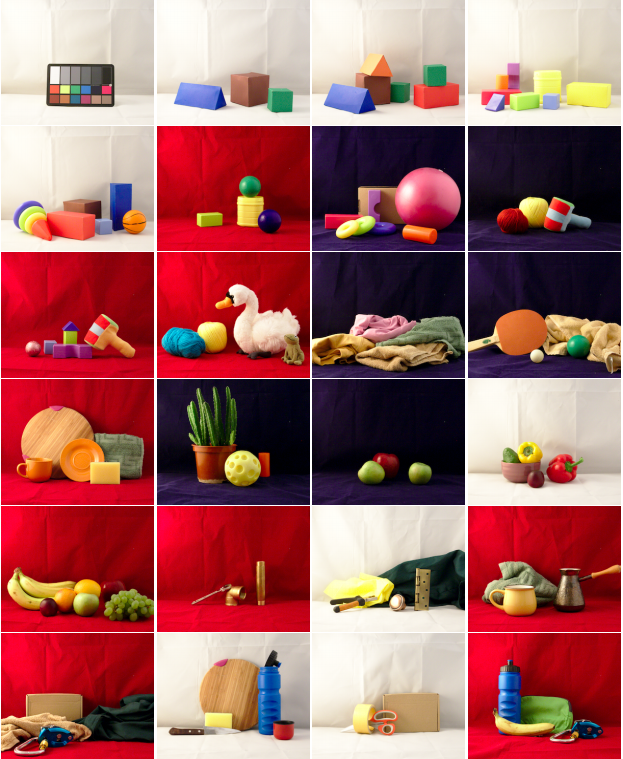

The next code section prepares the dataset. The dataset images are printed at 
the end.

In [61]:
# Transforms
normalize_transform =  tv.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
crop = tv.transforms.FiveCrop(size=IMG_SHAPE[0])
pre_norm_transform = tv.transforms.Compose([crop])
norm_transform = tv.transforms.Compose([normalize_transform])

# Data details
num_scenes = 24
ignore_scenes = {1,} # 0: the Macbeth chart
scenes = [s for s in range(1, num_scenes+1) if s not in ignore_scenes]
crops = ['topleft', 'topright', 'bottomleft', 'bottomright', 'center']
Crop = namedtuple('Crop', 'y, x, h, w')
Scene = namedtuple('Scene', 'imagenet_label, id, crop') 
# Choose a crop size that allows for 5 sub-crops of size 224.
crop_size = int(224 * 3/2) # 336 
scenes = [
    Scene('bath towel',      11, Crop(157, 264, crop_size, crop_size)),
    Scene('ping-pong ball',  12, Crop(230, 110, 263,       292)),       # Image made smaller to keep ball in all crops.
    Scene('cup',             13, Crop(157,   0, crop_size, crop_size)), # Not sure if 'cup' or 'coffee mug' is the best class.
    Scene('pot',             14, Crop(117,  50, crop_size, crop_size)), 
    Scene('Granny Smith',    15, Crop(185, 264, crop_size, crop_size)), 
    Scene('bell pepper',     16, Crop(157, 216, crop_size, crop_size)), 
    Scene('banana',          17, Crop(157,   0, crop_size, crop_size)), # This image also contains an orange and apple.
    Scene('coffee mug',      20, Crop(197,  15, 296,       crop_size)), # Image made to keep the cup in all crops.
    Scene('water bottle',    22, Crop( 65, 264, crop_size, crop_size)), 
    Scene('water bottle',    24, Crop( 65,   0, crop_size, crop_size)), # This image also contains a banana.
    Scene('banana',          24, Crop(197,  50, 296,       crop_size))] # This image also contains a water bottle.
illuminants = [
    '2HAL_DESK_LED-B025',
    '2HAL_DESK_LED-B050',
    '2HAL_DESK_LED-B075',
    '2HAL_DESK_LED-B100',
    '2HAL_DESK_LED-BG025',
    '2HAL_DESK_LED-BG050',
    '2HAL_DESK_LED-BG075',
    '2HAL_DESK_LED-BG100',
    '2HAL_DESK_R025',
    '2HAL_DESK_R050',
    '2HAL_DESK_R075',
    '2HAL_DESK_R100',
    '2HAL_DESK_RG025',
    '2HAL_DESK_RG050',
    '2HAL_DESK_RG075',
    '2HAL_DESK_RG100',
    '2HAL_DESK',
    '2HAL']


def img_key(scene_id, imagenet_label, crop_label, illuminant):
    return f'{scene_id}.{imagenet_label}.{crop_label}.{illuminant}'


def rec_2020_to_sRGB(rgb_img):
    """Convert image in REC2020 linear colorspace to an sRGB colorspace image.
    
    This method didn't actually seem to work, yet I'm not exactly sure why, so 
    I'm keeping it here so I can come back and try understand why it isn't working. 
    Below, I ended up using the inbuilt features of PIL instead.
    """
    # Rec 2020 to CIE XYZ
    to_xyz_mat = torch.tensor([[6.36953507e-01, 1.44619185e-01, 1.68855854e-01], 
                               [2.62698339e-01, 6.78008766e-01, 5.92928953e-02], 
                               [4.99407097e-17, 2.80731358e-02, 1.06082723e+00]])
    def dot_vector(m, v):
        return  torch.einsum('...ij,...j->...i', m, v)
    xyz = dot_vector(to_xyz_mat, rgb_img)
    
    # CIE XYZ to sRGB
    to_linear_rgb_mat = torch.tensor([
        [3.2406, -1.5372, -0.4986],
        [-0.9689, 1.8758, 0.0415],
        [0.0557, 0.2040, 1.057]])
    linear_rgb = dot_vector(to_linear_rgb_mat, xyz)
    
    def to_srgb(c):
        res = 12.92*c if c <= 0.0031308 else (1.055 * c**(1/2.4) - 0.055)
        return res
    s_rgb = linear_rgb.apply_(to_srgb)
    s_rgb_chw = einops.rearrange(s_rgb, 'h w c -> c h w')
    return s_rgb_chw


def open_as_srgb(img_path):
    """Open an image and convert it to sRGB.
    
    The image must have an embedded ICC color profile."""
    img = PIL.Image.open(img_path)
    icc = tempfile.mkstemp(suffix='.icc')[1]
    with open(icc, 'wb') as f:
        f.write(img.info.get('icc_profile'))
    srgb = PIL.ImageCms.createProfile('sRGB')
    img = PIL.ImageCms.profileToProfile(img, icc, srgb)
    return img
    
    
def open_img(scene, illuminant):
    """Open the image corresponding to the given scene and illuminant."""
    img_path = ds_path / 'images_preview' / f'{scene.id:02d}' / f'{scene.id:02d}_{illuminant}.jpg'
    img = open_as_srgb(img_path) 
    img = np.array(img, dtype=np.float32)
    cropped = img[scene.crop.y:scene.crop.y+scene.crop.h, scene.crop.x:scene.crop.x+scene.crop.w, :]
    return cropped


def create_dataset():
    """
    Dataset as a dict. Keys are of the form: 04-topleft-2HAL_DESK_LED-B025.
    Images are 0-1 tensors.
    """
    images = dict()
    for s in scenes:
        for ill in illuminants:
            img = open_img(s, ill)
            #img = np.asarray(img, dtype=np.float32) / 255.0
            img = img / 255.0
            img = torch.tensor(einops.rearrange(img, 'h w c -> c h w'))
            cropped_images = pre_norm_transform(img)
            for crop_label, ci in zip(crops, cropped_images):
                images[img_key(s.id, s.imagenet_label, crop_label, ill)] = ci
    return images

ds = create_dataset()


def get_ds_image(ds, scene, illuminant, subcrop):
    # img is torch in CxHxW format.
    img = ds[img_key(scene.id, scene.imagenet_label, subcrop, illuminant)]
    img = einops.rearrange(img, 'c h w -> h w c').numpy()
    return img


def print_originals():
    """Print the images before the 5-crop transformation.
    
    Only images for one illumination are printed."""
    images = []
    labels = []
    for s in scenes:
        img = open_img(s, illuminants[-2])
        labels.append(s.imagenet_label)
        images.append(img)
    imlist(images, labels)
            

def print_dataset(inc_illuminants=None):
    """Print the dataset images.
    
    Args:
        inc_illuminants (set): restrict the illuminants to this set. Without
                               setting this option, the number of images printed
                               with be quite large (11x5x18).
   """
    if not inc_illuminants:
        inc_illuminants = set(illuminants)
    ds = create_dataset()
    tab_labels = []
    images = []
    custom_labels = []
    for k,v in ds.items():
        sid, imagenet_label, crop, illuminant = k.split('.')
        if not illuminant in inc_illuminants:
            continue
        tab_labels.append(illuminant)
        images.append(einops.rearrange(v.numpy(), 'c h w -> h w c'))
        custom_labels.append(f'{imagenet_label} ({crop})')
        
    ipyplot.plot_class_tabs(images, tab_labels, custom_labels, max_imgs_per_tab=200)

The following images are the hand-chosen 11 different 336x366 crops, under 2HAL illumination (two halogen lights).

/opt/conda/lib/python3.8/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)



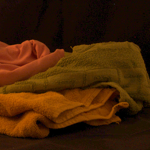
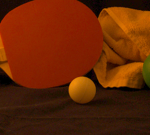
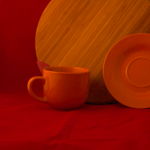
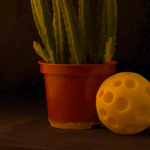
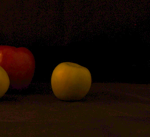
...
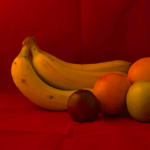
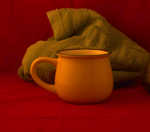
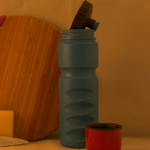
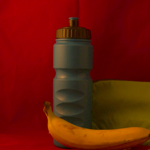
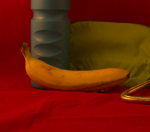

In [7]:
print_originals()

Below, is a subset of the whole dataset. The 11 336x336 are cropped into 5 different 224x224 images, and this is done for all 18 illuminations. Below, only 3 out of the 18 illuminations are shown.


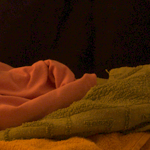
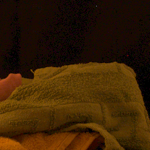
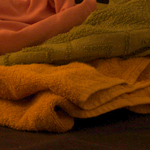
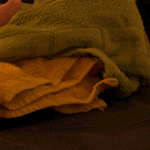
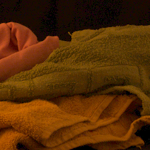
...
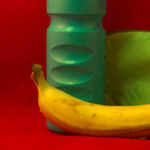
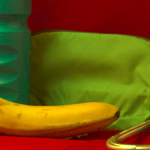
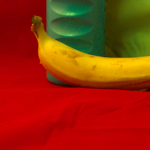
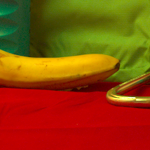
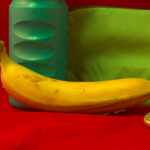

In [8]:
inc_illuminants={'2HAL_DESK', '2HAL_DESK_RG075', '2HAL_DESK_LED-B100'}
print_dataset(inc_illuminants)

## 2. Method
Same as experiment 2.0.0. 

Pass each of the 11x18x5 (11 scenes, 18 illuminations, 5 crops) preview images
into a ResNet model for classification. The ResNet model is pretrained for 
ImageNet classification. Record every classification. 

In [9]:
def run_all_images_through_ResNet():
    """Input the images into the ResNet model and collect results.
    
    Returns: results as an xarray.DataArray.
    """
    ds = create_dataset()
    raw_data = np.zeros((len(scenes), len(crops), len(illuminants), NUM_CLASSES))
    classification_val_id_pairs = []
    for idx, s in enumerate(scenes): 
        for crop_idx, crop in enumerate(crops):
            classification_ids = []
            for ill_idx, ill in enumerate(illuminants):
                img = ds[img_key(s.id, s.imagenet_label, crop, ill)]
                input_ = torch.unsqueeze(normalize_transform(img), 0).to(device)
                model_out = model.forward(input_)
                raw_data[idx][crop_idx][ill_idx][:] = model_out.squeeze().detach().cpu()
    xdata = xr.DataArray(raw_data,  
                         coords={'scene':range(len(scenes)), 'crop':crops,  'illuminant':illuminants, 
                                 'class_id':np.arange(0, NUM_CLASSES)})
    return xdata
data = run_all_images_through_ResNet()

## 3. Inspect data, part 1. Some figures.
The data is inspected to see how illumination effects the ResNet outputs.

The data s a 4 dimensional table of floats. Each 1000 floats grouped into the
last dimension "class_id" collectively represent the 1000 outputs of ResNet for
a single input image. The following summary from xarray shows some more 
details:

In [10]:
data

<xarray.DataArray (scene: 11, crop: 5, illuminant: 18, class_id: 1000)>
array([[[[-3.24409544e-01,  1.51148155e-01, -2.07823768e-01, ...,
           7.04832971e-01,  5.18043876e-01,  2.35058594e+00],
         [-6.99496329e-01,  7.43473053e-01,  1.39205849e+00, ...,
           1.33801627e+00,  1.21157670e+00,  2.61213422e+00],
         [ 6.59414053e-01,  1.60070992e+00,  3.32006240e+00, ...,
           1.61466169e+00,  1.41385376e+00,  2.10242009e+00],
         ...,
         [ 1.39444757e+00,  5.34894288e-01, -1.14235783e+00, ...,
           1.10097980e+00,  2.84895134e+00,  4.95624542e-01],
         [-6.07358396e-01,  8.87729943e-01, -7.01845348e-01, ...,
          -4.63770330e-01,  1.34083843e+00,  4.08778477e+00],
         [-3.40771854e-01,  7.21929431e-01, -3.99301261e-01, ...,
          -7.71338701e-01,  1.16432822e+00,  2.65818024e+00]],

        [[ 2.52115059e+00,  1.10113502e+00,  1.28040063e+00, ...,
           1.64936721e+00,  6.80361629e-01,  3.62506795e+00],
         [ 1.56004488e-01,  1.35139990e+00,  3.45075583e+00, ...,
           9.24115896e-01,  7.22388506e-01,  4.61354876e+00],
         [ 1.53164363e+00,  8.19041729e-01,  3.18627048e+00, ...,
           1.69803834e+00,  2.06544304e+00,  4.20115328e+00],
...
         [ 1.56987417e+00,  2.24115396e+00,  1.78421184e-01, ...,
           4.41058636e+00,  1.63478518e+00,  1.72179544e+00],
         [ 5.18623292e-01,  8.10788453e-01,  1.27589905e+00, ...,
           3.08756185e+00,  6.75022840e-01,  2.52900863e+00],
         [ 8.93000782e-01,  7.30728865e-01,  2.31409764e+00, ...,
           2.64553976e+00,  2.08276659e-01,  2.34969187e+00]],

        [[-1.17861295e+00, -3.01117867e-01,  2.07789153e-01, ...,
           5.73351085e-01,  7.82464981e-01,  1.74563241e+00],
         [-2.06990170e+00,  1.32802010e+00,  1.50249934e+00, ...,
           3.61703843e-01,  6.11318588e-01,  2.20769453e+00],
         [-2.60438395e+00,  2.38337064e+00,  1.28610253e+00, ...,
           5.16770542e-01,  1.88809729e+00,  2.72667980e+00],
         ...,
         [ 3.90494406e-01,  1.69335938e+00, -1.83853462e-01, ...,
           3.82660317e+00,  3.87007666e+00,  1.79271030e+00],
         [-2.23518181e+00,  1.64475763e+00,  9.64056373e-01, ...,
           1.51083803e+00,  1.54600668e+00,  1.64360774e+00],
         [-6.06312931e-01,  1.63821828e+00,  5.28693378e-01, ...,
           2.19789004e+00,  8.58115330e-02,  3.28577423e+00]]]])
Coordinates:
  * scene       (scene) int64 0 1 2 3 4 5 6 7 8 9 10
  * crop        (crop) <U11 'topleft' 'topright' ... 'bottomright' 'center'
  * illuminant  (illuminant) <U19 '2HAL_DESK_LED-B025' ... '2HAL'
  * class_id    (class_id) int64 0 1 2 3 4 5 6 7 ... 993 994 995 996 997 998 999

I'll skip explaining the below code, and I'll delay explanations until the
figures are printed.

In [22]:
# Organise the data into some useful formats. 
# These results are used throughout the rest of the notebook. 
#
# 1. classifications
#    Flatten the class_id dimension so that the table is now a table of the 
#    class ids chosen by the ResNet model (the max class output).
# 2. is_equal_ground_truth 
#    The classifications table is converted to true/false depending on whether 
#    the output matches the ground truth (ground truth is decided by me).
# 3. classification_hist
#    A pseudo histogram. Count how many different classes ImageNet classifies a 
#    single scene-crop image set. That is, over all 18 illuminations, how many 
#    different classes are assigned by ResNet?
# 4. diversities
#    The classification_hist can be seen as a list of distributions. For each
#    distribution, calculate a measure of diversity. The measure of diversity 
#    chosen is entropy.
classifications = data.argmax(dim='class_id')
is_equal_groundtruth = []
for idx, group in classifications.groupby('scene'):
    is_equal_groundtruth.append(xr.where(group == label_to_class_id(scenes[idx].imagenet_label), True, False))
is_equal_groundtruth = xr.concat(is_equal_groundtruth, dim='scene')

def entropy(x):
    """Shannon entropy."""
    x = x / x.sum()
    # Filled allows log(0) to be ignored and set as 0.
    l = np.ma.log2(x).filled(0)
    entr = -np.sum(x*l)
    return entr
diversity_measure = entropy

def unique_counts(x):
    _, unique_counts = np.unique(x, return_counts=True)
    # There can be as many as 18 unique classes; however in reality, 
    # the most I saw was 7, so I'd like to set the number of bins 
    # to be about 8 to make the graphs clearer. Unfortunately,
    # xarray forces the output axis to have the same size as 
    # the original, so we are stuck with 18.
    bin_count = len(illuminants)
    res = np.zeros([bin_count])
    res[0:len(unique_counts)] = unique_counts
    return res
classification_hist = classifications.reduce(
    lambda x,axis: np.apply_along_axis(unique_counts, axis, x), 
    dim='illuminant')
diversities = classification_hist.reduce(
    lambda x,axis: np.apply_along_axis(diversity_measure, axis, x),
    dim='illuminant')
ave_scores = data.max(dim='class_id').mean(dim='illuminant')

In [23]:
def show_pseudo_distribution_grid():
    # The most unique classifications observed for a given scene-crop was 8 (maximum 
    # possible is 18, the number of illuminations). Cutting off the extra x axis makes
    # the charts less compacted, so hopefully easier to read.
    max_unique = 8 
    fg = classification_hist.isel(illuminant=slice(0, max_unique+1)).plot.step(x='illuminant', col='crop', row='scene')
    fg.set_axis_labels('classes', 'classification counts')
    for ax in fg.axes.flat:
        #ax.get_xaxis().set_visible(False)

        ax.tick_params(labelbottom=False)
    fg.fig.tight_layout()
    IPython.display.display(IPython.display.Markdown('### Classification histograms for each scene-crop pair'))
    IPython.display.display(IPython.display.Markdown('The x-axis represents _unordered_ ImageNet classes that '
                                                     'the machine thought was most likely for _at least one illuminant_.'))
    fg.fig.show()
   

### Classification histograms
First up we have a grid of distribution-like figures. The grid of figures tries 
to express the variation in ResNet output classification as the illuminant is 
varied. 

The creation of the grid is explained in more detail underneath.

### Classification histograms for each scene-crop pair

The x-axis represents _unordered_ ImageNet classes that the machine thought was most likely for _at least one illuminant_.

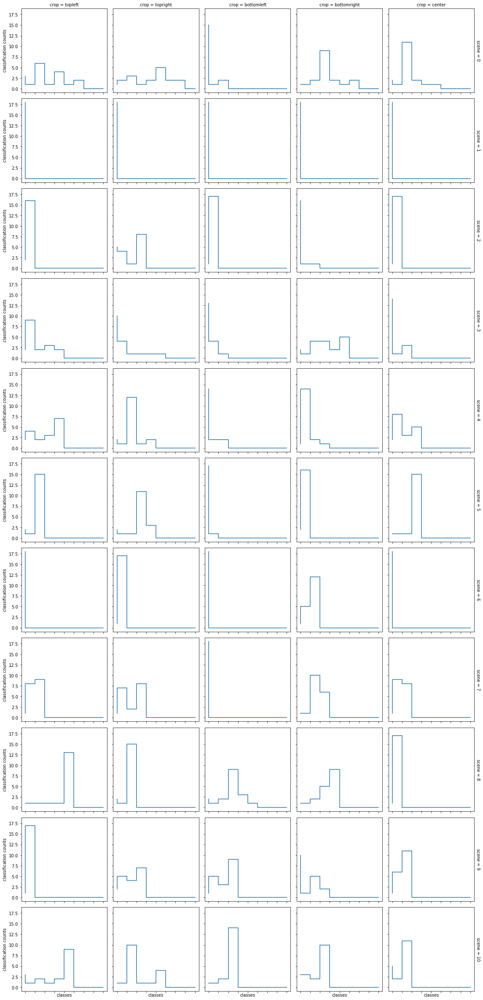

In [24]:
show_pseudo_distribution_grid()

#### Figure details 
There are 11x5 figures (11 scenes, 5 crops). Each figure represents
a single (scene, crop) pair. Each figure tallies the 18 
classifications, binned by the ImageNet class id. However, if processing was 
stopped here, each figure would have an x-axis with 1000 bins, which would make
it hard to view. So, I fixed a sufficient domain size (8 bins) and for each
figure, I removed the class-id entries that had a tally of zero. I removed 
enough of these entries so that all figures have the same number of bins. The
maximum number of non-zero bins was 8, hence 8 being chosen for the domain 
size.

#### Some issues with the figure
The grid of figures are a bit hard to read. In future, I'll avoid using xarray's plot functionality, as it is difficult to configure, which makes it hard to create nice and readable figures. Most frustratingly, xarray doesn't support bar charts, so I have used a step chart, which is as close as I can get. 

In addition, because of the removal of classes from each figure, the information
about what class each x-axis position corresponds to is lost. Furthermore, there
is no x-axis correspondence between the figures.

### Entropy
The above 55 (11x5) figures are showing the classification distribution as illumination is varied (for fixed a scene-crop). We can condense each of these distributions into a single number that measures the diversity inherent in the distribution: more diversity means ResNet was less decisive in it's classification as illumination varied. The specific measure for diversity I'll use is entropy (Shannon entropy). Below is the 55 distributions plotted against their entropy (x-axis). To spread the points in 2D, and to add some more information to the chart, I've plotted the points against a measure of the model's confidence. This confidence measure maximum output activation of ResNet, averaged over the 18 illuminations.

(Note: there are multiple ways one can measure diversity; entropy seems fine for this situtaion. (Diversity measures is an interesting topic in itself; Tom Leinster's ideas on diversity are great, for example: https://arxiv.org/abs/2012.02113. I try to find any excuse at all to read something by Tom Leinster.)

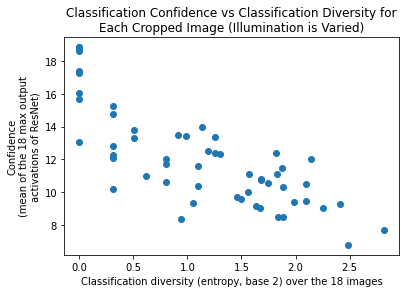

In [25]:
plt.scatter(diversities, ave_scores)
plt.title('Classification Confidence vs Classification Diversity for\nEach Cropped Image (Illumination is Varied)')
plt.xlabel('Classification diversity (entropy, base 2) over the 18 images')
plt.ylabel('Confidence\n(mean of the 18 max output\nactivations of ResNet)')
plt.show()

The mean diversity measure is:

In [26]:
mean_diversity = diversities.mean()
mean_diversity.data

array(1.12799598)

### Mean diversity lower for experiment 2.0.1
For ResNet-18, we have mean diversity of 1.13. This mean is lower than what was 
obtained in experiment 2.0.0 (1.43). So, if images have relatively obvious 
ImageNet labels, the illumination has less of an effect on the output. This 
doesn't seem surprising; the more uncertain the ResNet model is, the more likely 
that the maximum confidence label has relatively low confidence, and that there 
are one or more other labels with not too dissimilar confidence. This means than
a change in illumination only needs to cause a small change in label confidence 
for the qualification of maximum confidence to switch to another label.

### Classification accuracy vs. illuminants
Below is a 2D table showing whether ResNet correctly labeled an image. Green
represents a correct classification, and black represents an incorrect 
classification. Illuminants vary over the y-axis and both scenes and crop vary 
over the x-axis.

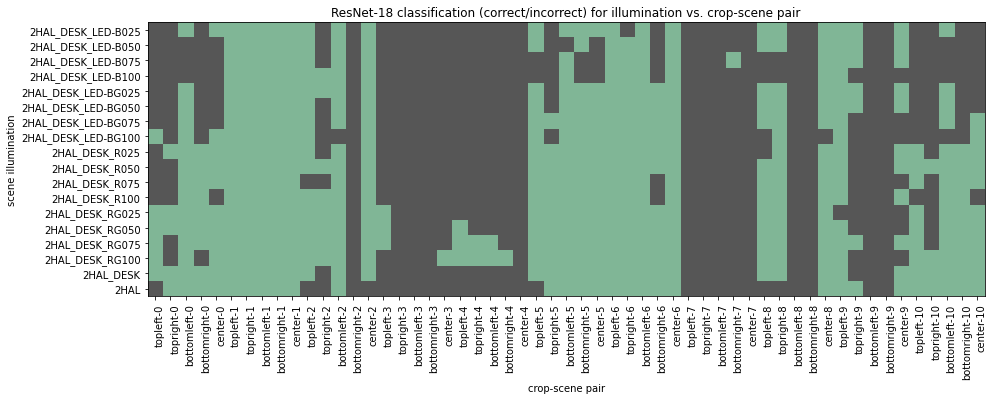

In [65]:
green = '#80b696'
gray = '#565656'
def plot_by_illuminant(condense=False):
    data = is_equal_groundtruth.stack(scene_crop=('scene', 'crop'))
    if condense:
        by_scene_crop = data.groupby('scene_crop')#, squeeze=True)
        non_zero = []
        for _,g in by_scene_crop:
            if g.any() and not g.all():
                non_zero.append(g)
        data = xr.concat(non_zero, dim='scene_crop')
    y_ticks = data.illuminant.data
    x_ticks = [f'{c}-{s}' for (s,c) in data.scene_crop.data]
    fig, ax = plt.subplots(figsize=(15,15))
    ax.set_title(f'{model_name_str()} classification (correct/incorrect) for illumination vs. crop-scene pair')
    ax.set_ylabel('scene illumination')
    ax.set_xlabel('crop-scene pair')
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    plt.setp(ax.get_xticklabels(), rotation=90, ha='right', rotation_mode='anchor')
    ax.set_xticklabels(x_ticks)
    ax.set_yticklabels(y_ticks)
    cmap = mpl.colors.ListedColormap([gray, green])
    ax.imshow(data, cmap=cmap)
    fig.show()
plot_by_illuminant(condense=False)

The 2D table is repeated again below, this time, empty columns are removed. 
Empty columns represent scene-crop pairs that were labeled identically under
every illumination. When investigating effects of illumination, it may be 
interesting to ignore these cases.

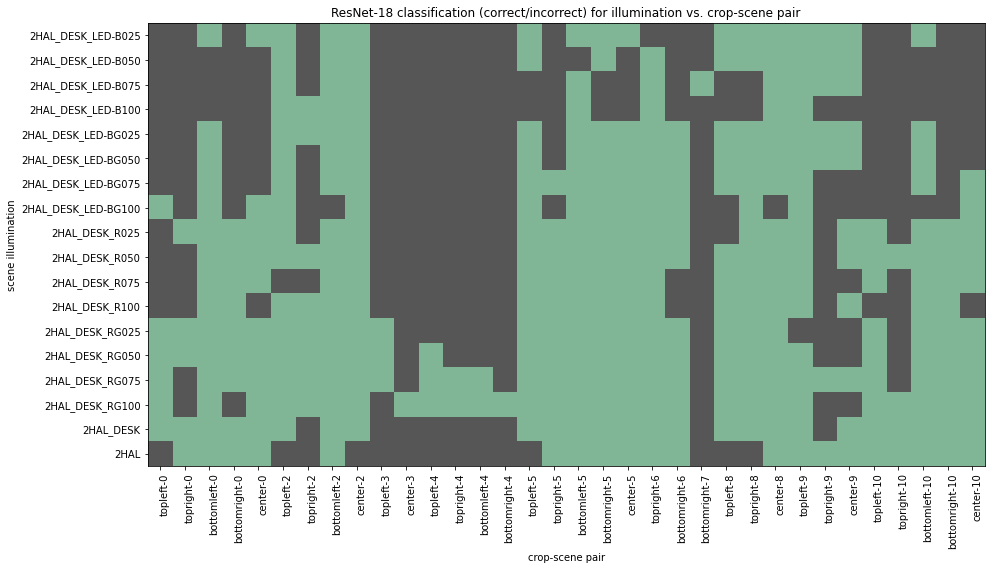

In [67]:
plot_by_illuminant(condense=True)

### Effect of illuminants
The above figure is transformed by summing along the x-axis 
(scene-crop axis disappears). The illumination axis stays the same. The x-axis
becomes a count.
Below is a figure with the number of successful classifications summed across scenes and crops, then plotted against illumination. From this we see that actually, there _is_ quite a difference between the different illuminants. The cube above is thus not a great visualization.

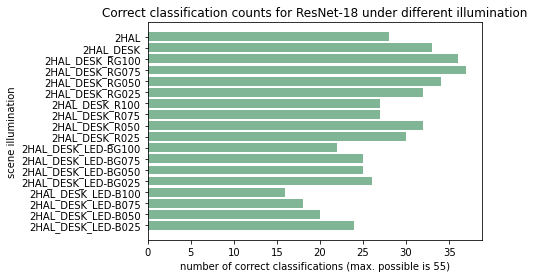

In [43]:
by_illuminant = is_equal_groundtruth.sum(dim=['scene', 'crop'])
#ans.plot()
fig, ax = plt.subplots()
ax.set_title(f'Correct classification counts for {model_name_str()} under different illumination')
ax.set_ylabel('scene illumination')
ax.set_xlabel('number of correct classifications (max. possible is 55)')
ax.set_yticks(np.arange(0, len(illuminants)))
ax.set_yticklabels(illuminants)
ax.barh(np.arange(len(illuminants)), by_illuminant.data, color=green)
fig.show()

## 3. Inspect data, part 2. Good illumination, bad illumination.
The above figures make it clear that illumination has an effect on 
classification accuracy. To get a better feel for the details of this effect, 
this section compares the best and worst illuminants. 

On average, the best illumination was the illumination where both the red and 
green LED lights were enabled and set at 75% power.

The worst illumination occurred with the LED set to blue only, at 100% power.
The next two worst illuminations were the same except for the LED power set to 
75% and 50%. The blue only LED setup at 25% power managed to just eclipse the 
blue-green LED setup at 100% power.

In both of these scenes there was also 2 halogen lights and 1 desktop lamps.

### Best: red-green. Worst: blue.

Best illuminant: 2HAL_DESK_RG075
Worst illuminant: 2HAL_DESK_LED-B100



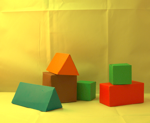
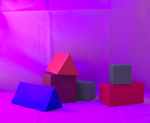


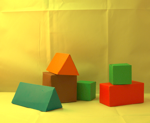
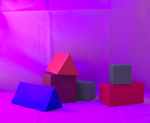

In [44]:
worst_illum, best_illum = illuminants[3], illuminants[14]
print(f'Best illuminant: {best_illum}')
print(f'Worst illuminant: {worst_illum}')
example_best = np.asarray(open_as_srgb(ds_path / 'images_preview' / '03' / f'03_{best_illum}.jpg'))
example_worst = np.asarray(open_as_srgb(ds_path / 'images_preview' / '03' / f'03_{worst_illum}.jpg'))
imlist([example_best, example_worst], ['best illuminant', 'worst illuminant'])

It might be useful to refer to the dataset printout shown towards the top
of the page; both of these illuminants were included as tabs.

Below we inspect the classifications for the two illuminations by dividing 
all scene-crop pairs into the four sets:

| best illumination | worst illumination |
|-------------------|--------------------|
| 🗸                 | 🗸                 |
| 🗸                 | ✖                  |
| ✖                 | 🗸                 |
| ✖                 | ✖                  |

Interestingly, as can be seen by the missing tab below, there were no images
for which ResNet failed under the good illumination but succeeded under the
bad illumination.

The images below come in pairs 
(best illumination followed by worst illumination). The tabs separate the
images into the 4 sets described above (except one class is empty).



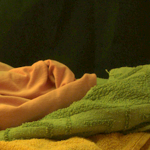
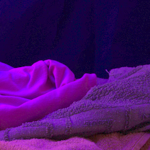
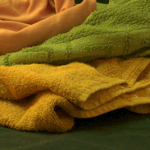
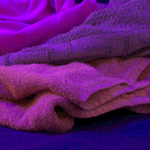
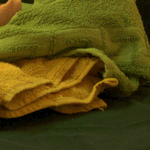
...
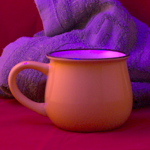
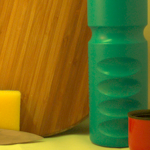
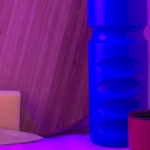
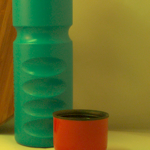
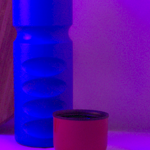

In [63]:
def compare_classifications():
    images = []
    tab_labels = []
    class_labels = []

    for s in is_equal_groundtruth.scene:
        for c in is_equal_groundtruth.crop:
            res_best_illum = is_equal_groundtruth.sel(scene=s, crop=c, illuminant=best_illum)
            res_worst_illum = is_equal_groundtruth.sel(scene=s, crop=c, illuminant=worst_illum)
            label = None
            if res_best_illum:
                if res_worst_illum:
                    label = 'both correct'
                else:    
                    label = 'best illum correct, worst illum incorrect'
            else:
                if res_worst_illum:
                    label = 'best illum incorrect, worst illum correct'
                else:
                    label = 'both incorrect'
            #images.append(open_img(scenes[s.data], best_illum))
            images.append(get_ds_image(ds, scenes[s.data], best_illum, c.data))
            images.append(get_ds_image(ds, scenes[s.data], worst_illum, c.data))
            class_labels.append(class_id_to_label(classifications.sel(scene=s, crop=c, illuminant=best_illum)))
            class_labels.append(class_id_to_label(classifications.sel(scene=s, crop=c, illuminant=worst_illum)))
            tab_labels.append(label)
            tab_labels.append(label)
    ipyplot.plot_class_tabs(images, tab_labels, class_labels)
compare_classifications()            

## 4. Discussion
Some ideas regarding the above data.

### Accuracy decreases under blue light
It seems that the model's accuracy suffers proportionally to how blue the
illumination is. It's interesting to see that the model labels many 
different images as being 'jellyfish' despite labeling them correctly in 
more red-green illumination. This result raises some questions about how
far reaching the effect is.

- does the accuracy continue to deteriorate under increasingly blue illumination?
- is this effect observed in for models trained on other datasets?
- does this issue cause issues for models trained with transfer learning?
- is blue illumination an effective attack method?